In [1]:
import os
import mne
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline
#%matplotlib notebook 交互式
%config InlineBackend.figure_format = 'svg' # 输出矢量图

## Access raw .cnt data

In [2]:
os.chdir("D:\psy_data\LJ\测试\CJ")
os.getcwd()
data = "test2.cnt"

Warning
Reading channel locations from the file header may be dangerous, as the x_coord and y_coord in ELECTLOC section of the header do not 
necessarily translate to absolute locations. Furthermore, EEG-electrode locations that do not fit to a sphere will distort the layout when 
computing the z-values. If you are not sure about the channel locations in the header, use of a montage is encouraged.

In [3]:
"""
By default, MNE does not load data into main memory to conserve resources. raw.filter requires raw data to be loaded. 
Use preload=True (or string) in the constructor or raw.load_data().
"""
raw = mne.io.read_raw_cnt(data, None, preload=True)
raw.set_eeg_reference(ref_channels=['M1', 'M2'], projection=False)
raw

Reading 0 ... 152439  =      0.000 ...   304.878 secs...


<ipython-input-3-40c3679ddfaf>:5: RuntimeWarning:   Could not parse meas date from the header. Setting to None.
  raw = mne.io.read_raw_cnt(data, None, preload=True)


Applying a custom EEG reference.


<RawCNT  |  test2.cnt, n_channels x n_times : 67 x 152440 (304.9 sec), ~78.0 MB, data loaded>

All metadata are stored in the `raw.info` attribute (It's Python `dict` with a nice `__repr__`)

In [4]:
raw.info

<Info | 18 non-empty fields
    bads : list | 0 items
    ch_names : list | FP1, FPZ, FP2, AF3, AF4, F7, F5, F3, F1, ...
    chs : list | 67 items (EEG: 66, STIM: 1)
    comps : list | 0 items
    custom_ref_applied : bool | True
    description : str | 0 items
    dev_head_t : Transform | 3 items
    events : list | 0 items
    highpass : float | 0.0 Hz
    hpi_meas : list | 0 items
    hpi_results : list | 0 items
    lowpass : float | 250.0 Hz
    meas_date : NoneType | unspecified
    nchan : int | 67
    proc_history : list | 0 items
    projs : list | 0 items
    sfreq : float | 500.0 Hz
    subject_info : dict | 5 items
    acq_pars : NoneType
    acq_stim : NoneType
    ctf_head_t : NoneType
    dev_ctf_t : NoneType
    dig : NoneType
    experimenter : NoneType
    file_id : NoneType
    gantry_angle : NoneType
    hpi_subsystem : NoneType
    kit_system_id : NoneType
    line_freq : NoneType
    meas_id : NoneType
    proj_id : NoneType
    proj_name : NoneType
    xplotter_l

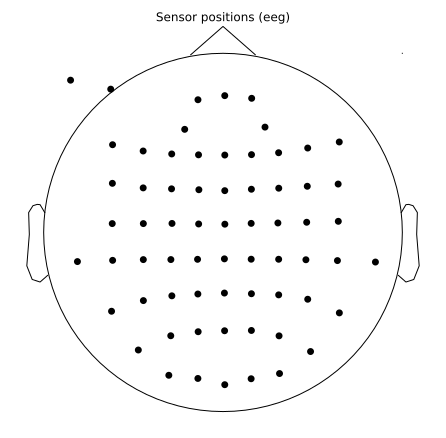

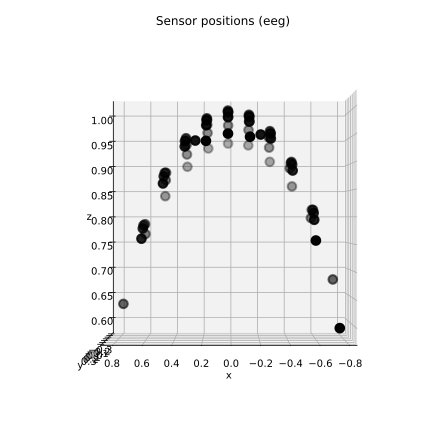

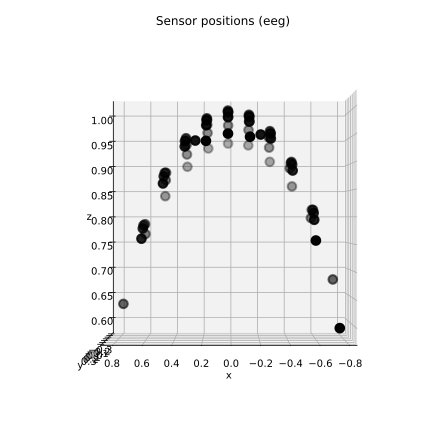

In [5]:
raw.plot_sensors()
raw.plot_sensors('3d') 

## Filtering

Band pass the data between 1Hz and 40Hz (based on `scipy.signal`)

In [6]:
raw.filter(1.0, 30.0, fir_design='firwin')

Setting up band-pass filter from 1 - 30 Hz
l_trans_bandwidth chosen to be 1.0 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 1651 samples (3.302 sec) selected


<RawCNT  |  test2.cnt, n_channels x n_times : 67 x 152440 (304.9 sec), ~78.0 MB, data loaded>

In [7]:
raw.info

<Info | 18 non-empty fields
    bads : list | 0 items
    ch_names : list | FP1, FPZ, FP2, AF3, AF4, F7, F5, F3, F1, ...
    chs : list | 67 items (EEG: 66, STIM: 1)
    comps : list | 0 items
    custom_ref_applied : bool | True
    description : str | 0 items
    dev_head_t : Transform | 3 items
    events : list | 0 items
    highpass : float | 1.0 Hz
    hpi_meas : list | 0 items
    hpi_results : list | 0 items
    lowpass : float | 30.0 Hz
    meas_date : NoneType | unspecified
    nchan : int | 67
    proc_history : list | 0 items
    projs : list | 0 items
    sfreq : float | 500.0 Hz
    subject_info : dict | 5 items
    acq_pars : NoneType
    acq_stim : NoneType
    ctf_head_t : NoneType
    dev_ctf_t : NoneType
    dig : NoneType
    experimenter : NoneType
    file_id : NoneType
    gantry_angle : NoneType
    hpi_subsystem : NoneType
    kit_system_id : NoneType
    line_freq : NoneType
    meas_id : NoneType
    proj_id : NoneType
    proj_name : NoneType
    xplotter_la

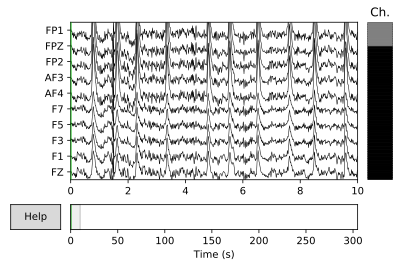

In [8]:
fig = raw.plot(n_channels=10) # n_channels: number of channels show imultaneously

Effective window size : 4.096 (s)


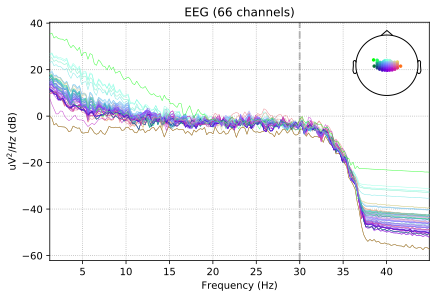

In [9]:
raw.plot_psd(fmin=1., fmax=45., tmax=60., average=False);

## Selecting subsets of channels and samples

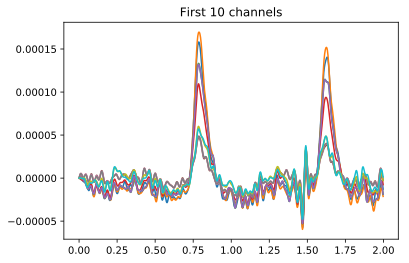

In [10]:
# Extract data from the first 10 channels, from 0 s to 2 s.
sfreq = raw.info['sfreq']
data, times = raw[:10, int(sfreq * 0):int(sfreq * 2)]
_ = plt.plot(times, data.T)
_ = plt.title('First 10 channels')

In [11]:
pick_chans =['P1','P3','P5']
specific_chans = raw.copy().pick_channels(pick_chans) #use .copy() or it will overwrite the data
print(specific_chans)

<RawCNT  |  test2.cnt, n_channels x n_times : 3 x 152440 (304.9 sec), ~3.5 MB, data loaded>


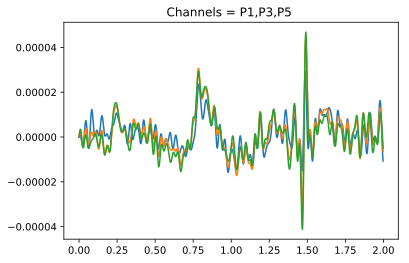

In [12]:
data_s, times_s = specific_chans[:, int(sfreq * 0):int(sfreq * 2)]
_ = plt.plot(times_s, data_s.T)
_ = plt.title('Channels = P1,P3,P5 ')

## Epochs and Events

Each presentation of a stimulus corresponds to an **epoch**.

An epoch is a segment of data around the presence of an **event**.

Let's extract events from the trigger/stimulation channel:

In [13]:
events = mne.find_events(raw, stim_channel='STI 014',output ='onset')

181 events found
Event IDs: [  1   2   3   4  11  12  13  14  15  16  17  18  19  20  21  22  23  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 211]


In [14]:
print(events)

[[   528      0      4]
 [  2043      0     11]
 [  3626      0     12]
 [  3724      0      1]
 [  5044      0      1]
 [  5200      0     93]
 [  6724      0      2]
 [  6916      0     61]
 [  8012      0      2]
 [  8449      0     86]
 [  9692      0      3]
 [ 10107      0     21]
 [ 11428      0      3]
 [ 11773      0     44]
 [ 13132      0      3]
 [ 13389      0     26]
 [ 14724      0      2]
 [ 15080      0     90]
 [ 16436      0      3]
 [ 16663      0     75]
 [ 18068      0      2]
 [ 18404      0     55]
 [ 19860      0      2]
 [ 20011      0     32]
 [ 21332      0      1]
 [ 21711      0     65]
 [ 23036      0      3]
 [ 23468      0     78]
 [ 24948      0      3]
 [ 25109      0     42]
 [ 26452      0      1]
 [ 26767      0     17]
 [ 28244      0      1]
 [ 28300      0     96]
 [ 29708      0      3]
 [ 29983      0     40]
 [ 31348      0      1]
 [ 31549      0     64]
 [ 32884      0      2]
 [ 33298      0    100]
 [ 34747      0      1]
 [ 34856      0 

In [15]:
"""
1是旧词，2是重组，3是新，码不变
11到40是旧词 = 4，41到70是重组词 = 5，71到100是新词 = 6
"""
recode_events = events[:]
for i in range(len(recode_events)):
    if recode_events[i][2] <= 5:
        recode_events[i][2] = recode_events[i][2]
    elif recode_events[i][2] <= 40:
        recode_events[i][2] = 4
    elif recode_events[i][2] <= 70:
        recode_events[i][2] = 5
    elif recode_events[i][2] <= 100:
        recode_events[i][2] = 6

Look at the design in a graphical way:

<ipython-input-16-1a396e1eb22c>:2: RuntimeWarning: event 211 missing from event_id will be ignored
  mne.viz.plot_events(events, raw.info['sfreq'], raw.first_samp, event_id=event_id);


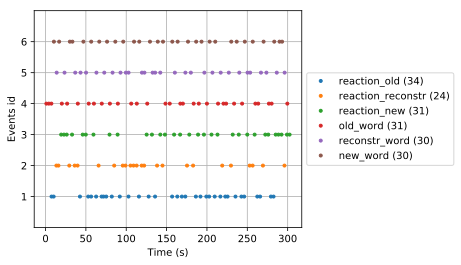

In [16]:
event_id = {"reaction_old": 1,"reaction_reconstr": 2,"reaction_new": 3, "old_word": 4,"reconstr_word": 5,"new_word": 6}
mne.viz.plot_events(events, raw.info['sfreq'], raw.first_samp, event_id=event_id);

## Find eog events

Using channel VEO as EOG channel
EOG channel index for this subject is: [65]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 2 - 45 Hz
Filter length of 8192 samples (16.384 sec) selected
Setting up band-pass filter from 1 - 10 Hz
Filter length of 8192 samples (16.384 sec) selected
Now detecting blinks and generating corresponding events
Number of EOG events detected : 303
Using channel HEO as EOG channel
EOG channel index for this subject is: [64]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 2 - 45 Hz
Filter length of 8192 samples (16.384 sec) selected
Setting up band-pass filter from 1 - 10 Hz
Filter length of 8192 samples (16.384 sec) selected
Now detecting blinks and generating corresponding events
Number of EOG events detected : 242


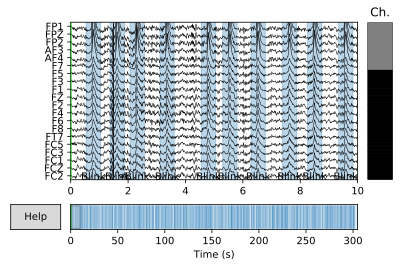

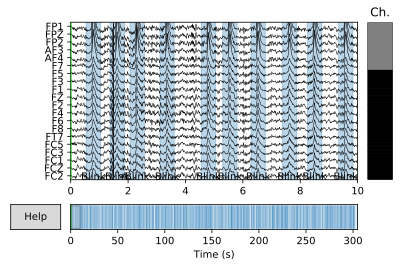

In [17]:
# find blinks
annotated_blink_raw = raw.copy()
veog_events = mne.preprocessing.find_eog_events(raw,  ch_name= 'VEO')
heog_events = mne.preprocessing.find_eog_events(raw,  ch_name= 'HEO')
n_blinks = len(veog_events)

# Turn blink events into Annotations of 0.5 seconds duration,
# each centered on the blink event:
onset = veog_events[:, 0] / raw.info['sfreq'] - 0.25
duration = np.repeat(0.5, n_blinks)
description = ['Blink'] * n_blinks
annot = mne.Annotations(onset, duration, description,
                        orig_time=raw.info['meas_date'])
annotated_blink_raw.set_annotations(annot)

# plot the annotated raw
annotated_blink_raw.plot()

## From raw to epochs

In [18]:
stimulus_events = {"old_word": 4,"reconstr_word": 5,"new_word": 6}
tmin, tmax = -0.2, 1.5  # start and end of an epoch in sec.
baseline = (-0.2, 0) # time interval to apply baseline correction
exclude = ['M1','M2','HEO','VEO','STI 014']
#decim = 2  # downsample the data to make the example faster to run
# Set up indices of channels to include in analysis
picks = mne.pick_types(raw.info, eeg=True, stim=False, eog=True, exclude=exclude)

epochs = mne.Epochs(raw, events, stimulus_events, tmin, tmax, proj=False,
                    picks=picks, baseline=baseline, preload=True)

print(epochs)

91 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
Loading data for 91 events and 851 original time points ...
0 bad epochs dropped
<Epochs  |   91 events (all good), -0.2 - 1.5 sec, baseline [-0.2, 0], ~36.7 MB, data loaded,
 'new_word': 30
 'old_word': 31
 'reconstr_word': 30>


In [19]:
data = epochs.get_data()
print(type(data))
print(data.shape)  # n_epochs, n_channels, n_times

<class 'numpy.ndarray'>
(91, 62, 851)


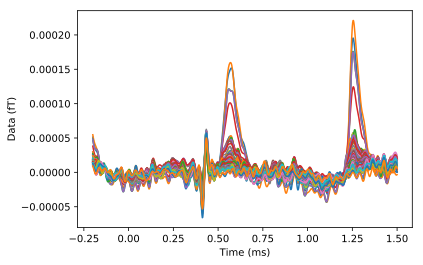

In [20]:
plt.plot(epochs.times, data[0,:,:].T)
plt.xlabel('Time (ms)')
plt.ylabel('Data (fT)');

### Use Independant Component Analysis (ICA) to find latent sources in the data

In [21]:
from mne.preprocessing import ICA

# Choose  parameters
n_components = 20  # if float, select n_components by explained variance of PCA
#decim = 3  # we need sufficient statistics, not all time points to saves time
random_state = 0 # same decomposition and the same order of components each time

ica = ICA(n_components = n_components, random_state=0, method = 'fastica').fit(epochs)

Fitting ICA to data using 62 channels (please be patient, this may take a while)
Inferring max_pca_components from picks
Selection by number: 20 components
Fitting ICA took 3.3s.


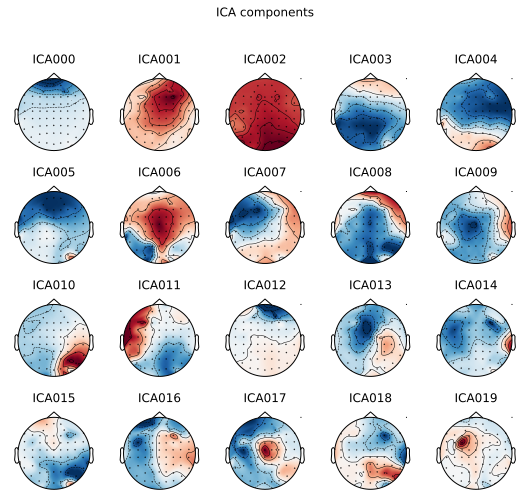

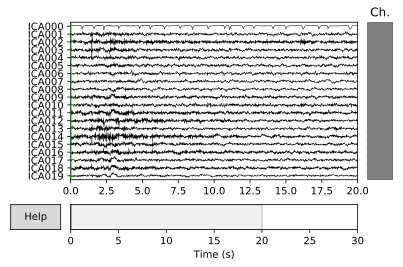

In [22]:
ica.plot_components();
ica.plot_sources(raw.copy().crop(0, 30));

### Component properties
Let’s take a closer look at properties of first three independent components

    Using multitaper spectrum estimation with 7 DPSS windows


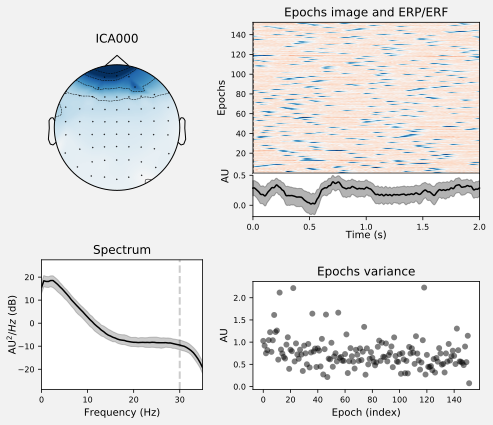

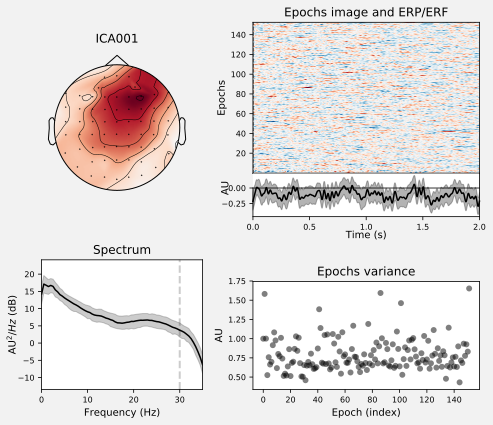

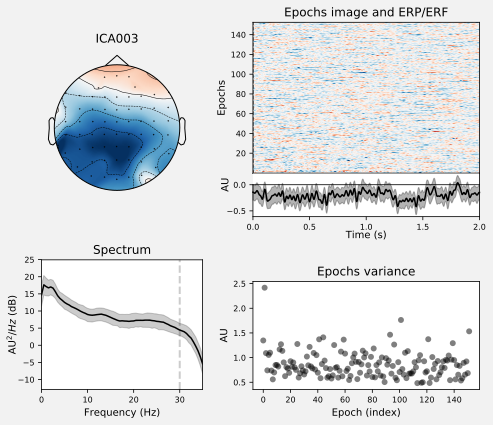

[<Figure size 504x432 with 5 Axes>,
 <Figure size 504x432 with 5 Axes>,
 <Figure size 504x432 with 5 Axes>]

In [23]:
%matplotlib inline
ica.plot_properties(raw, picks=[0,1,3],psd_args={'fmax': 35.})

### Remove artifact

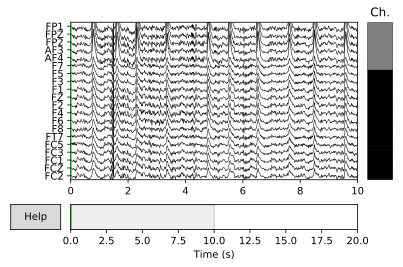

Transforming to ICA space (20 components)
Zeroing out 1 ICA components


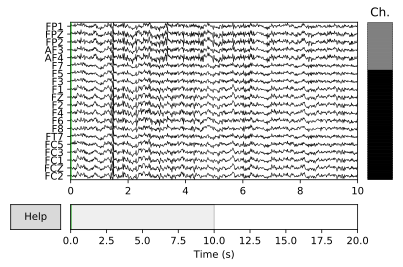

Transforming to ICA space (20 components)
Zeroing out 1 ICA components


<Epochs  |   91 events (all good), -0.2 - 1.5 sec, baseline [-0.2, 0], ~36.7 MB, data loaded,
 'new_word': 30
 'old_word': 31
 'reconstr_word': 30>

In [24]:
raw_copy = raw.copy().crop(0, 20)
raw_copy.plot()
ica_exclude = [0]
ica.apply(raw_copy, exclude=ica_exclude)
raw_copy.plot()
ica.apply(epochs, exclude=ica_exclude)

### Average across trial types

In [25]:
ev_old = epochs['old_word'].average()
ev_reconstr = epochs['reconstr_word'].average()
ev_new = epochs['new_word'].average()

f, axs = plt.subplots(3, 1, figsize=(10, 5))
_ = ev_old.plot(axes=axs[0], show=False, time_unit='s', titles = 'old')
_ = ev_reconstr.plot(axes=axs[1], show=False, titles='reconstr')
_ = ev_new.plot(axes=axs[2], show=False, titles='new')
plt.tight_layout()

### Average all epochs to denoise

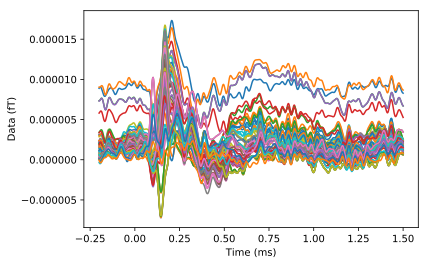

In [26]:
import numpy as np

data_mean = np.mean(data, axis=0)

plt.plot(epochs.times,  data_mean.T)
plt.xlabel('Time (ms)')
plt.ylabel('Data (fT)');

### Do this with MNE Evoked data structure

The average response of the brain is called the **evoked** response.
Evoked data structure is mainly used for storing averaged data over trials. 
In MNE the evoked objects are usually created by averaging epochs data with mne.Epochs.average().

In [27]:
evoked = epochs.average()
print(evoked.data.shape) # (n_channels, n_times)
print(evoked.nave)  # Number of averaged epochs.
print(evoked.first)  # First time sample.
print(evoked.last)  # Last time sample.
print(evoked.comment)  # Comment on dataset. Usually the condition.
print(evoked.kind)  # Type of data, either average or standard_error.

(62, 851)
91
-100
750
0.34 * old_word + 0.33 * reconstr_word + 0.33 * new_word
average


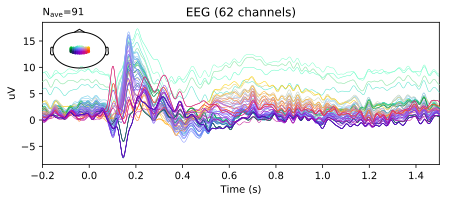

In [28]:
evoked.plot(spatial_colors=True);

## Topomaps

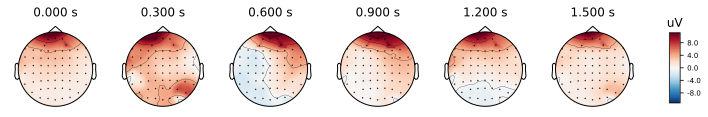

In [29]:
evoked.plot_topomap(times=np.linspace(0, 1.5, 6));

### Plot both jointly

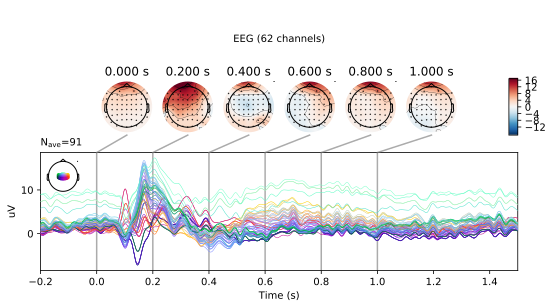

In [30]:
evoked.plot_joint(times=np.linspace(0, 1, 6));

### Plot interactively with ipywidgets

In [31]:
%matplotlib inline
from ipywidgets import interact
import ipywidgets as widgets

@interact(time=(evoked.times[0], evoked.times[-1], 0.01))
def plot_topo(time):
    evoked.plot_topomap(times=[time], size=3., vmin=-15., vmax=15.)

interactive(children=(FloatSlider(value=0.6399999999999999, description='time', max=1.5, min=-0.2, step=0.01),…

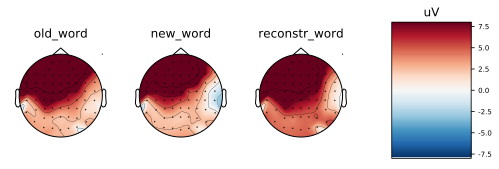

In [32]:
evoked_stimulus = [epochs["old_word"].average(), epochs["new_word"].average(), epochs["reconstr_word"].average()]
fig, ax = plt.subplots(1, 4, figsize=(8, 2))
kwargs = dict(times=0.2, show=False, vmin=-8, vmax=8, time_unit='s')
evoked_stimulus[0].plot_topomap(axes=ax[0], colorbar=True, **kwargs)
evoked_stimulus[1].plot_topomap(axes=ax[1], colorbar=False, **kwargs)
evoked_stimulus[2].plot_topomap(axes=ax[2], colorbar=False, **kwargs)
for ax, title in zip(ax[:3], ['old_word', 'new_word', 'reconstr_word']):
    ax.set_title(title)
plt.show()

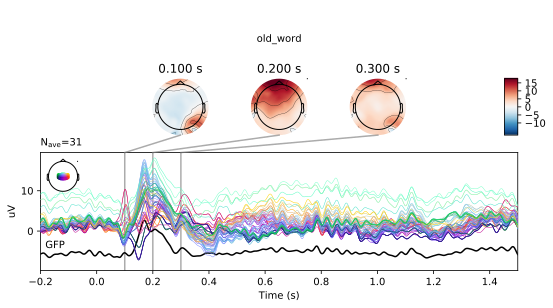

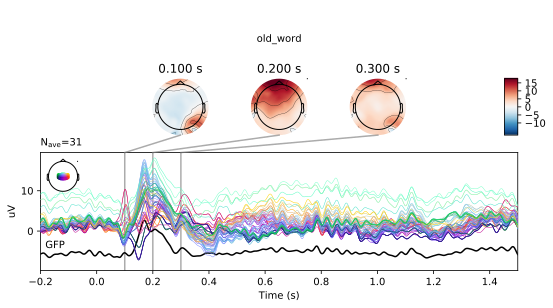

In [33]:
ts_args = dict(gfp=True, time_unit='s')
topomap_args = dict(sensors=False, time_unit='s')
evoked_stimulus[0].plot_joint(title='old_word', times=[.1, .2, .3],
                        ts_args=ts_args, topomap_args=topomap_args)

## Time-Frequency Analysis

### Frequency analysis

    Using multitaper spectrum estimation with 7 DPSS windows


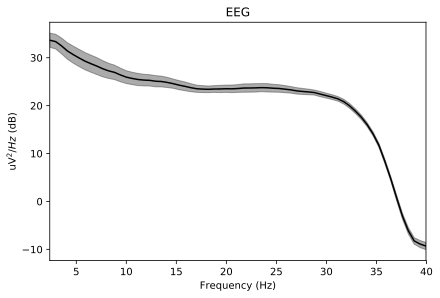

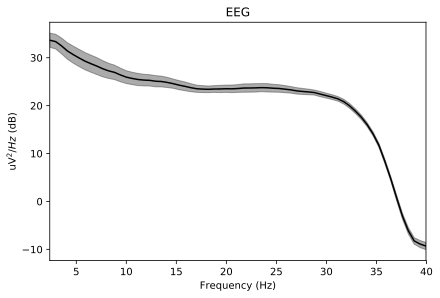

In [34]:
from mne.time_frequency import tfr_morlet, psd_multitaper

epochs.plot_psd(fmin=2., fmax=40.) #  all channel types by averaging across epochs.

    Using multitaper spectrum estimation with 7 DPSS windows


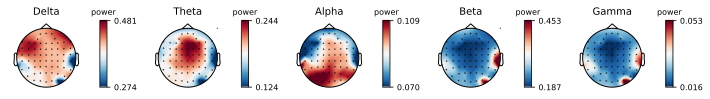

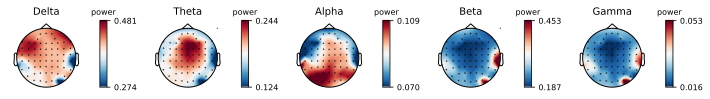

In [35]:
epochs.plot_psd_topomap(normalize=True)

### Time-frequency analysis: power and inter-trial coherence

Applying baseline correction (mode: logratio)


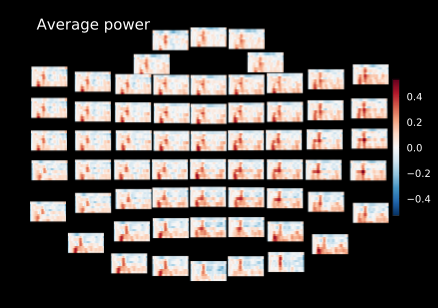

Applying baseline correction (mode: logratio)


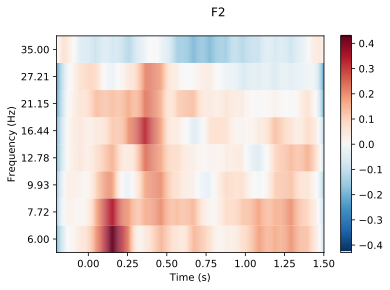

Applying baseline correction (mode: logratio)
Applying baseline correction (mode: logratio)


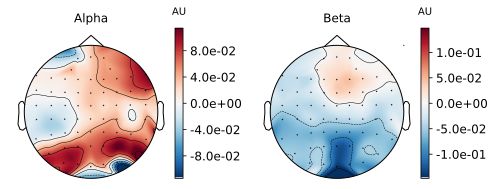

In [36]:
# define frequencies of interest (log-spaced)
freqs = np.logspace(*np.log10([6, 35]), num=8)
n_cycles = freqs / 2.  # different number of cycle per frequency
power, itc = tfr_morlet(epochs, freqs=freqs, n_cycles=n_cycles, use_fft=True,
                        return_itc=True, decim=3, n_jobs=1)

power.plot_topo(baseline=(-0.5, 0), mode='logratio', title='Average power')
power.plot([10], baseline=(-0.5, 0), mode='logratio', title=power.ch_names[10])

fig, axis = plt.subplots(1, 2, figsize=(7, 4))
power.plot_topomap(tmin=0.5, tmax=1.5, fmin=8, fmax=12,
                   baseline=(-0.5, 0), mode='logratio', axes=axis[0],
                   title='Alpha', show=False)
power.plot_topomap(tmin=0.5, tmax=1.5, fmin=13, fmax=25,
                   baseline=(-0.5, 0), mode='logratio', axes=axis[1],
                   title='Beta', show=False)
mne.viz.tight_layout()
plt.show()

Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


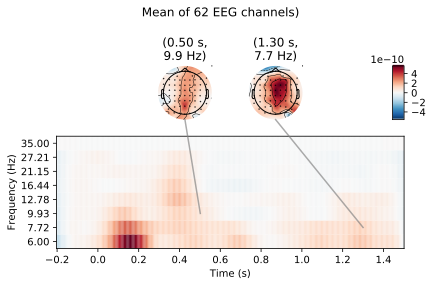

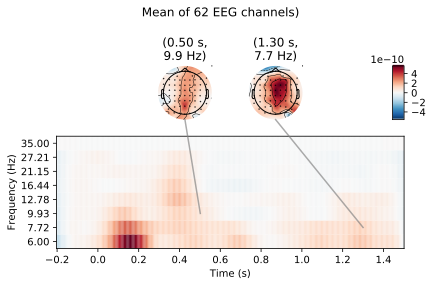

In [37]:
power.plot_joint(baseline=(-0.5, 0), mode='mean', tmin=-.5, tmax=2,
                 timefreqs=[(.5, 10), (1.3, 8)])

No baseline correction applied


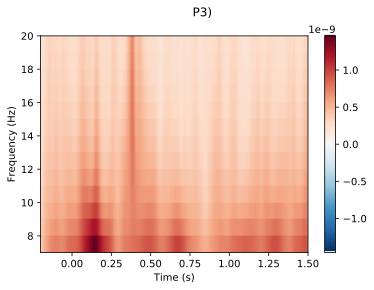

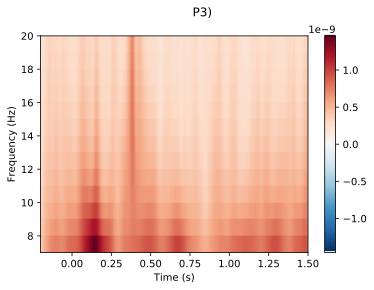

In [38]:
from mne.time_frequency import tfr_morlet, psd_multitaper

n_cycles = 2  # number of cycles in Morlet wavelet
freqs_oi = np.arange(7, 20, 1)  # frequencies of interest: alpha
chan_oi = 'P3'
#decim = 3

power, itc = tfr_morlet(epochs, freqs=freqs_oi, n_cycles=n_cycles,
                        return_itc=True, n_jobs=1)
power.plot([power.ch_names.index(chan_oi)])

## MVPA

Let's import some [scikit-learn](http://scikit-learn.org) building blocks and the rest from `
mne.decoding` module:

In [39]:
from sklearn.model_selection import StratifiedKFold
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.preprocessing import MinMaxScaler

from mne import io, pick_types, read_events, Epochs
from mne.preprocessing import Xdawn
from mne.decoding import Vectorizer
from mne.viz import tight_layout

Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPIRICAL
Done.
Estimating covariance using EMPI

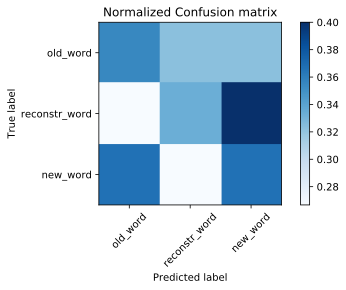

In [40]:
# Create classification pipeline
clf = make_pipeline(Xdawn(n_components=3),
                    Vectorizer(),
                    MinMaxScaler(),
                    LogisticRegression(penalty='l1', solver='liblinear',
                                       multi_class='auto'))

# Get the labels
labels = epochs.events[:, -1]

# Cross validator
cv = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

# Do cross-validation
preds = np.empty(len(labels))
for train, test in cv.split(epochs, labels):
    clf.fit(epochs[train], labels[train])
    preds[test] = clf.predict(epochs[test])

# Classification report
target_names = ["old_word", "reconstr_word", "new_word"]
report = classification_report(labels, preds, target_names=target_names)
print(report)

# Normalized confusion matrix
cm = confusion_matrix(labels, preds)
cm_normalized = cm.astype(float) / cm.sum(axis=1)[:, np.newaxis]

# Plot confusion matrix
plt.imshow(cm_normalized, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Normalized Confusion matrix')
plt.colorbar()
tick_marks = np.arange(len(target_names))
plt.xticks(tick_marks, target_names, rotation=45)
plt.yticks(tick_marks, target_names)
tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [ ]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score

from mne.decoding import SlidingEstimator, cross_val_multiscore

In [ ]:
picks = mne.pick_types(epochs.info, eeg=True)
X = epochs.get_data()[:, picks]
y = epochs.events[:, 2] 
print(X.shape, "EEG signals: (n_epochs, n_channels, n_times)")
print(y.shape, "target: old_word, reconstr_word, and new_word")

In [ ]:
clf = make_pipeline(StandardScaler(), LogisticRegression())

X_2d = X.reshape(len(X), -1)
scores = cross_val_score(clf, X_2d, y, cv=5, n_jobs=1, scoring='accuracy')

# Mean scores across cross-validation splits
print("Cross-validation (Accuracy) score : %s" % np.mean(scores))

Now let's do it time point by time point using MNE

In [ ]:
time_decod = SlidingEstimator(clf, n_jobs=1, scoring='roc_auc')
scores = cross_val_multiscore(time_decod, X, y, cv=5, n_jobs=1)

# Mean scores across cross-validation splits for each time instant
scores = np.mean(scores, axis=0)
print(scores.shape)
print(X.shape)

Then plot CV score over time.

In [ ]:
fig, ax = plt.subplots()
ax.plot(epochs.times, scores, label='score')
ax.axhline(.5, color='k', linestyle='--', label='chance')
ax.set_xlabel('Times')
ax.set_ylabel('AUC')  # Area Under the Curve
ax.legend()
ax.axvline(.0, color='k', linestyle='-')
ax.set_title('Sensor space decoding')
plt.show()